
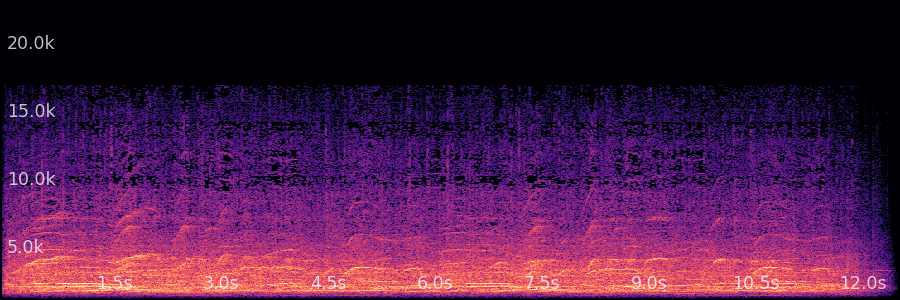
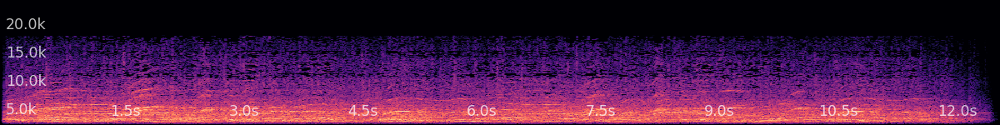


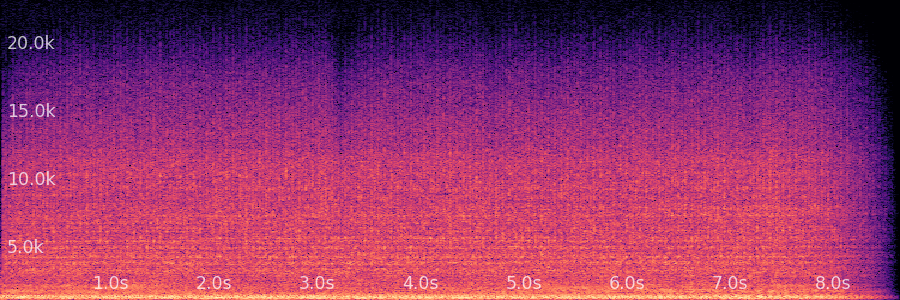
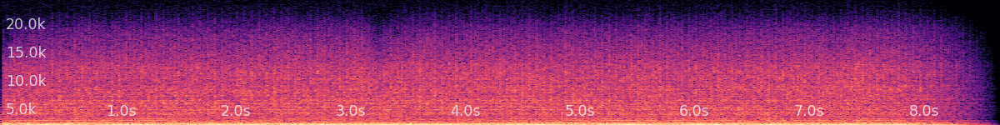

/usr/local/lib/python3.10/dist-packages/audiotools/core/audio_signal.py:601: UserWarning: Audio amplitude > 1 clipped when saving
  warnings.warn("Audio amplitude > 1 clipped when saving")



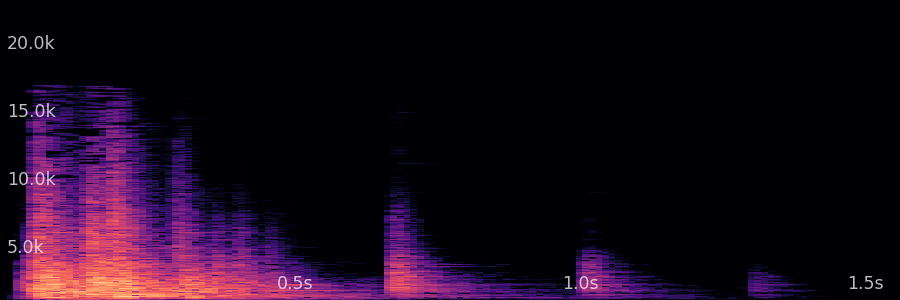
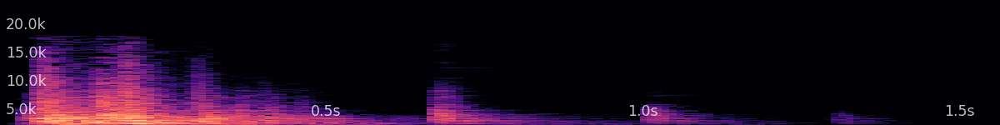


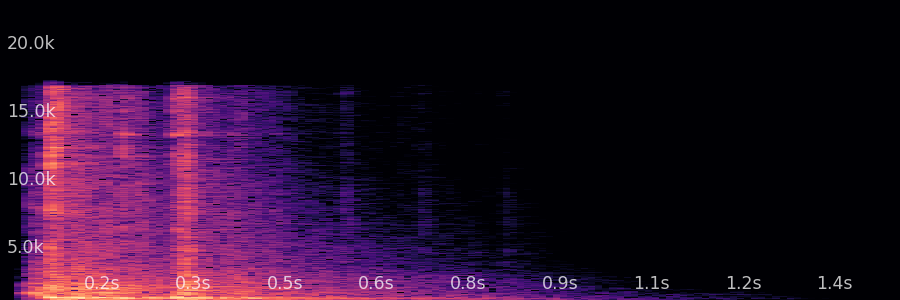
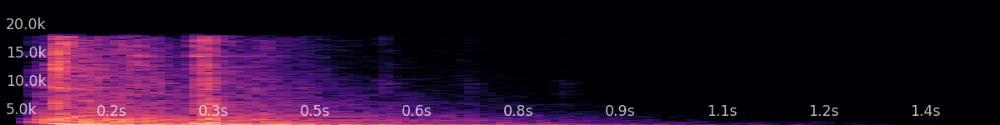


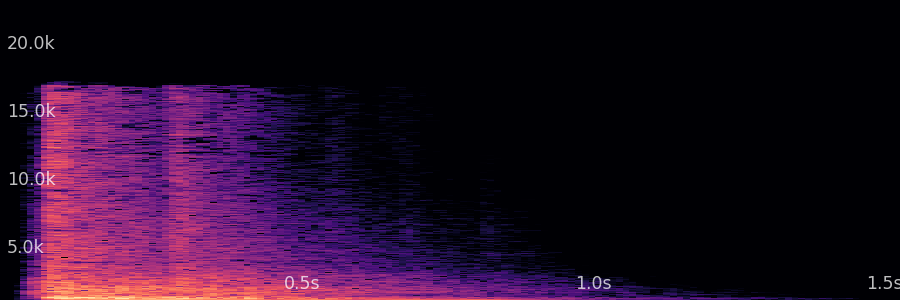
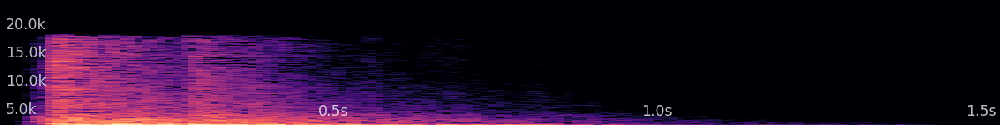

In [2]:
from audiotools import AudioSignal

examples = [
    "../dataset/05_loud applause.mp3",
    "../dataset/1.propellar aircraft sound.wav",
    "../dataset/11_metal door shutting 01.mp3",
    "../dataset/11_metal door shutting 02.mp3",
    "../dataset/11_metal door shutting 03.mp3",
    "../dataset/24.sail flapping on the wind.wav",
    "../dataset/27_cow sound effect.mp3",
    "../dataset/29.cartoon punch sound effect.wav",
]

e0 = AudioSignal(examples[0], sample_rate=16000).to_mono()
e1 = AudioSignal(examples[1], sample_rate=16000).to_mono()
e2 = AudioSignal(examples[2], sample_rate=16000).to_mono()
e3 = AudioSignal(examples[3], sample_rate=16000).to_mono()
e4 = AudioSignal(examples[4], sample_rate=16000).to_mono()

e0.widget()
e1.widget()
e2.widget()
e3.widget()
e4.widget()

In [3]:
import torch
import random

EPS = torch.finfo(torch.float32).eps
def pre_process(audio_path, total_duration):
    durad = 3.0
    duration = durad if total_duration >= 3 else total_duration  # Duration is 3 seconds or total_duration if less than 3
    
    if total_duration < durad: # 3초보다 짧으면 그냥 사용
        offset = 0.0
    else:
        # 3초보다 길면 랜덤한 구간에서 3초를 가져와서 사용
        max_offset = total_duration - duration  # Calculate the maximum possible offset
        offset = random.uniform(0, max_offset)  # Choose a random offset within the possible range
    
    # Load audio signal file
    wav = AudioSignal(audio_path, offset=offset, duration=duration)
    length = wav.signal_length

    wav.to_mono()
    wav.resample(16000)

    if wav.duration < durad: # 3초보다 짧으면 패딩으로 채우기
      pad_len = int(durad * 16000) - wav.signal_length
      wav.zero_pad(0, pad_len)
    assert wav.duration <= durad # 3초보다 길면? 안되는데 그러면

    return wav.audio_data, length

def normalize(audio):
    audio = audio/(audio.max(1)[0].abs().unsqueeze(1) + EPS)
    
    rms = (audio**2).mean(1).pow(0.5)
    scalar = 10**(-25/20) / (rms + EPS)
    audio = audio * scalar.unsqueeze(1)

    return audio


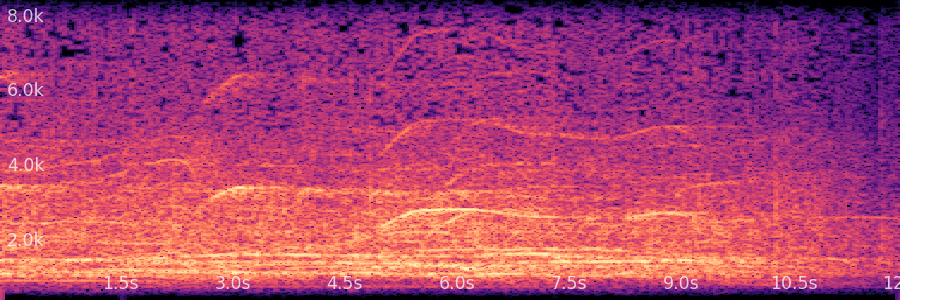
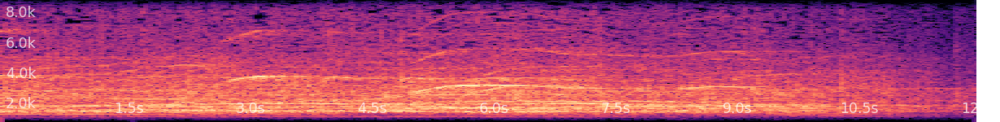


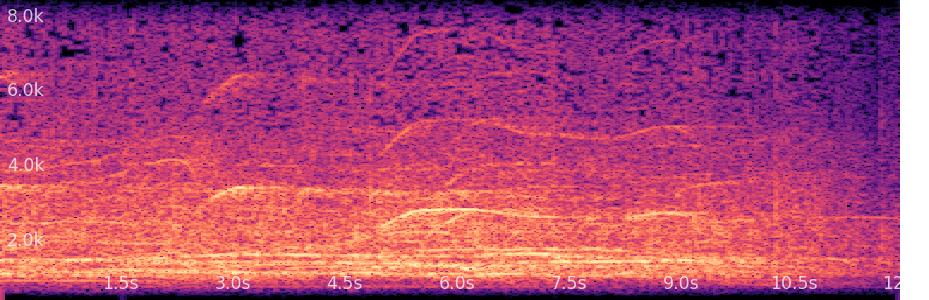
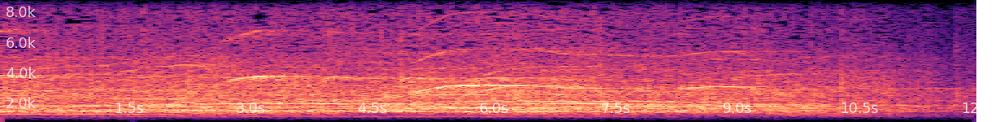


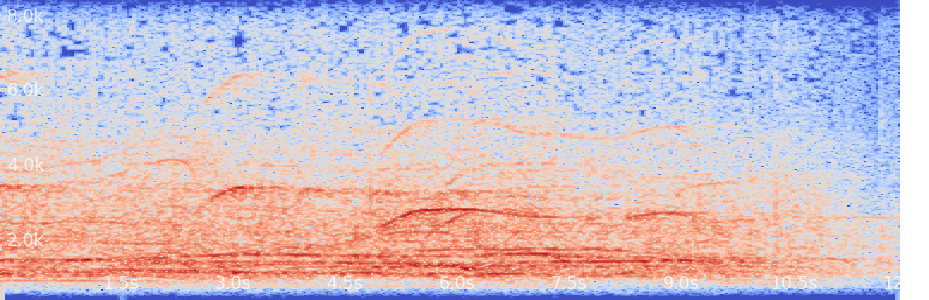
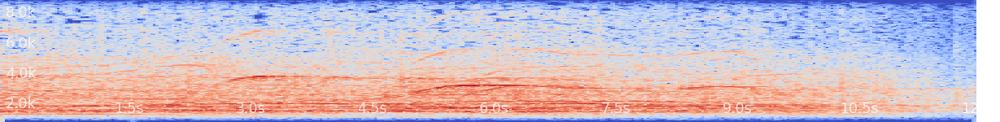

In [11]:
# 볼륨 키우기
wav, length = pre_process(examples[0], e0.duration)
wav = wav.squeeze(1)
AudioSignal(wav, sample_rate=16000).widget()

normalized_wav = normalize(wav)
AudioSignal(normalized_wav, sample_rate=16000).widget()
AudioSignal(normalized_wav*3, sample_rate=16000).widget()


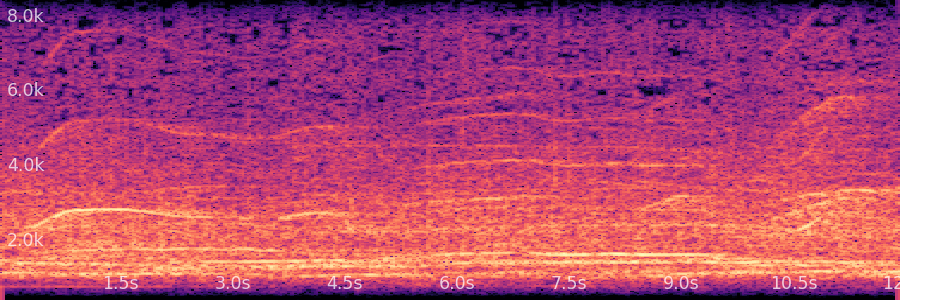
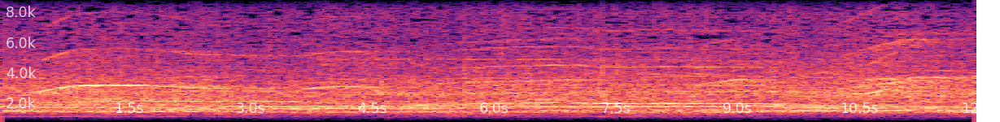


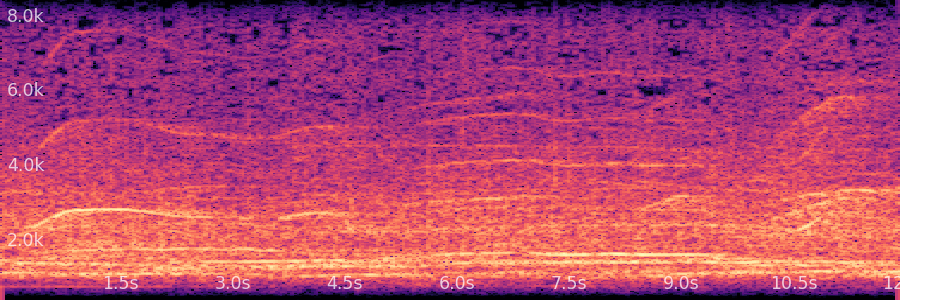
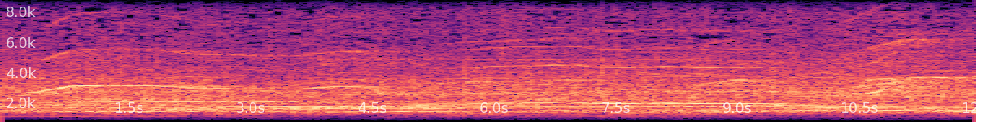


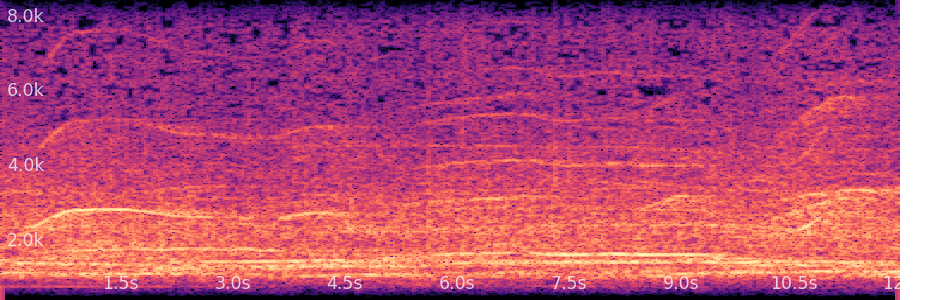
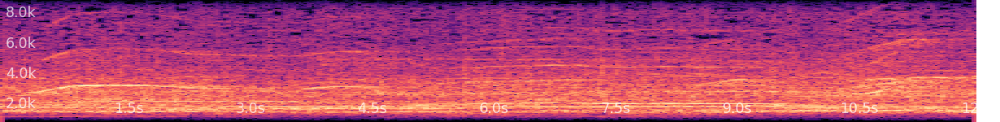

In [12]:
# 볼륨 줄이기
wav, length = pre_process(examples[0], e0.duration)
wav = wav.squeeze(1)
AudioSignal(wav, sample_rate=16000).widget()

normalized_wav = normalize(wav)
AudioSignal(normalized_wav, sample_rate=16000).widget()
AudioSignal(normalized_wav/2, sample_rate=16000).widget()


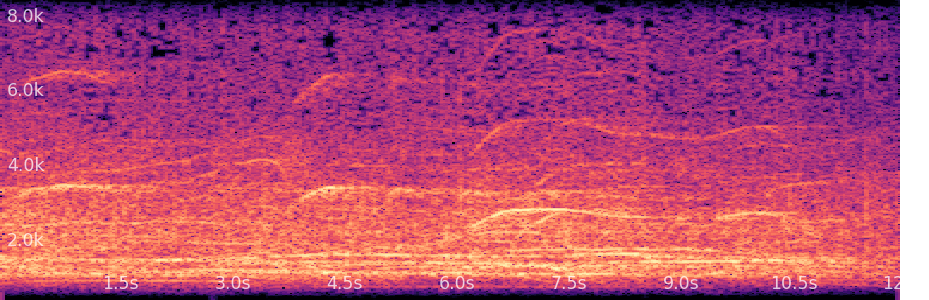
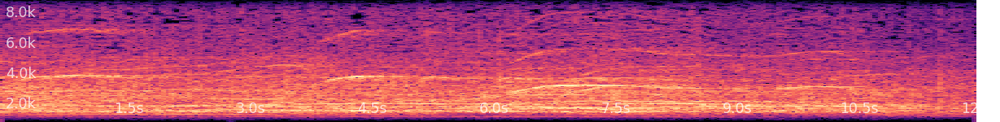


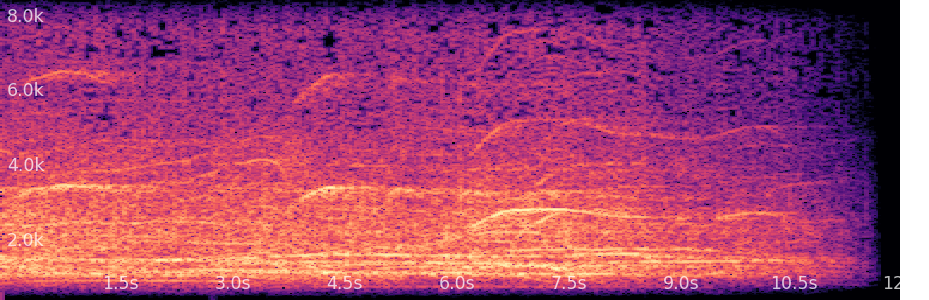
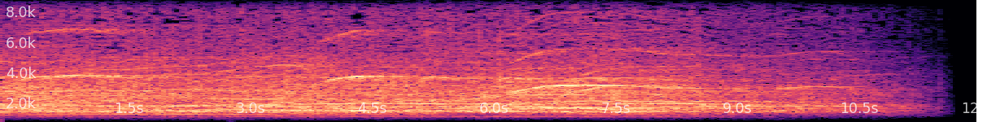


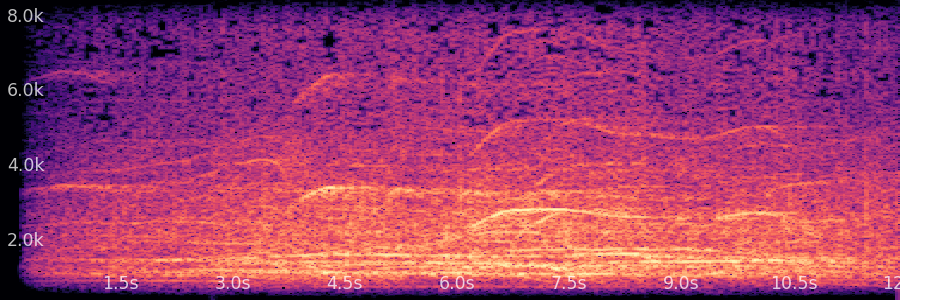
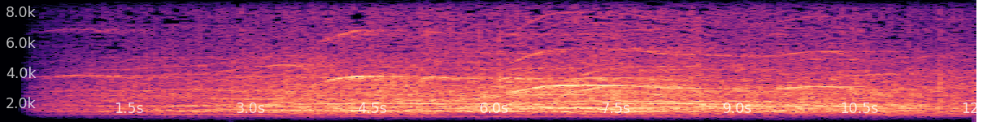

In [38]:
# Generate a linear fade-out curve (from 1 to 0)
import numpy as np
sr = 16000
# 볼륨 줄이기
wav, length = pre_process(examples[0], e0.duration)
wav = wav.squeeze(1)
normalized_wav = normalize(wav)
AudioSignal(normalized_wav, sample_rate=sr).widget()

how_long_decresendo = random.randint(11,18)/10
leng = int(sr*how_long_decresendo)
fade_curve = np.concatenate((np.linspace(1, 0, leng-1000), np.zeros(1000)))
wav2 = normalized_wav.clone()
wav2[0][-leng:] = wav2[0][-leng:] * fade_curve
AudioSignal(wav2, sample_rate=sr).widget()

fade_curve = np.concatenate((np.zeros(1000), np.linspace(0, 1, leng-1000)))
wav3 = normalized_wav.clone()
wav3[0][:leng] = wav3[0][:leng] * fade_curve
AudioSignal(wav3, sample_rate=sr).widget()

12.6171875 12.617142857142857



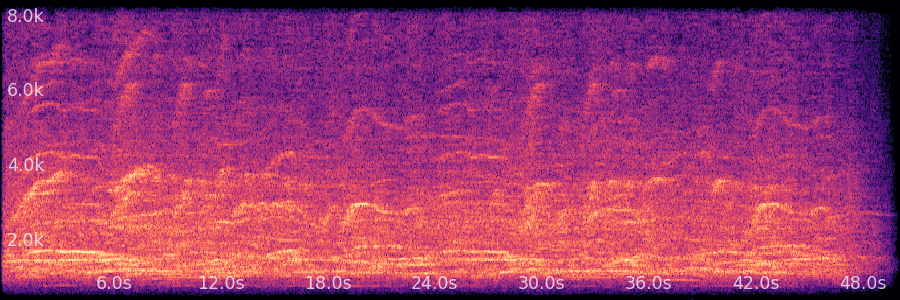
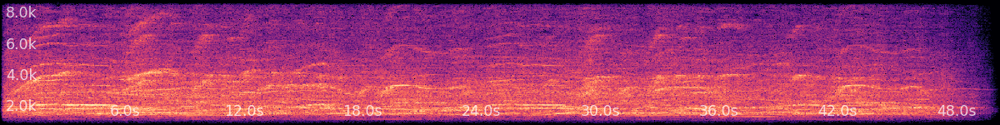


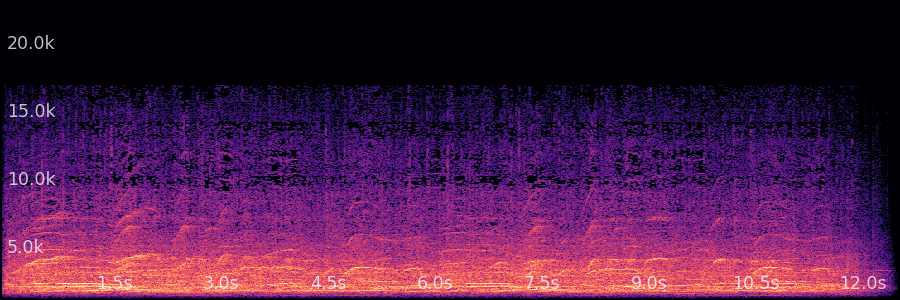
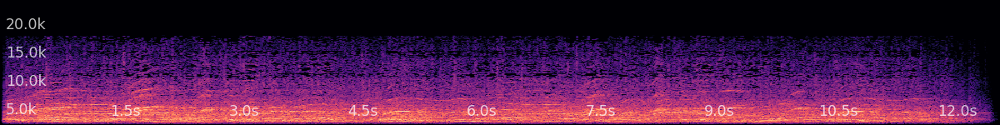

In [31]:
from librosa import load
import librosa

infile = examples[0]
y, sr = load(infile, sr=16000)
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=1)

made = AudioSignal(y_shifted, sample_rate=16000)
print(made.duration, e0.duration)
made.widget()
e0.widget()

(23406,)



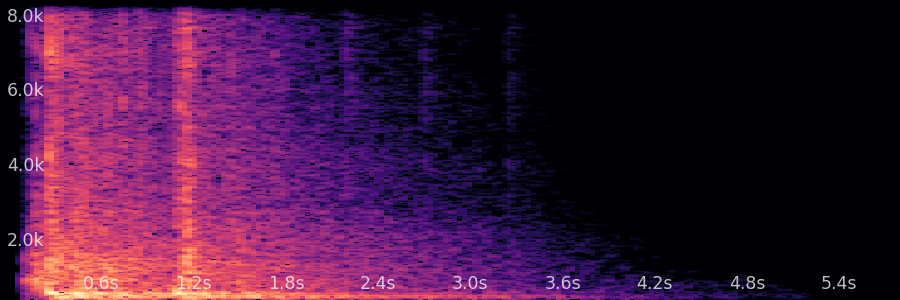
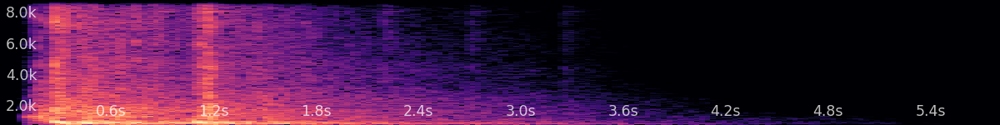

1.462875 12.617142857142857



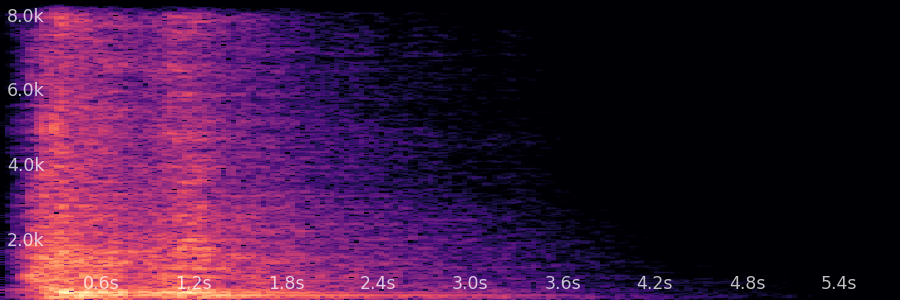
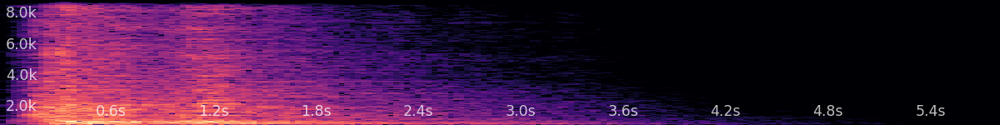


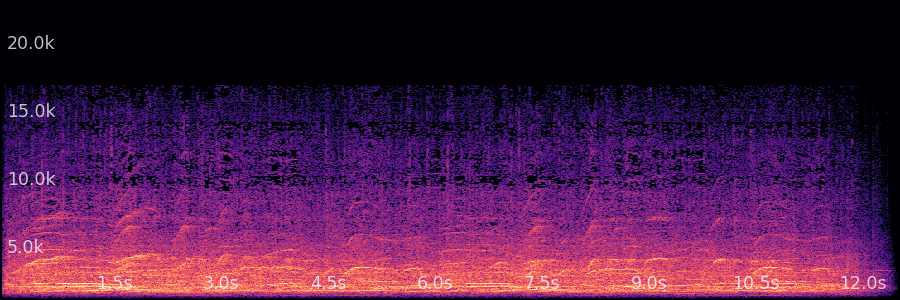
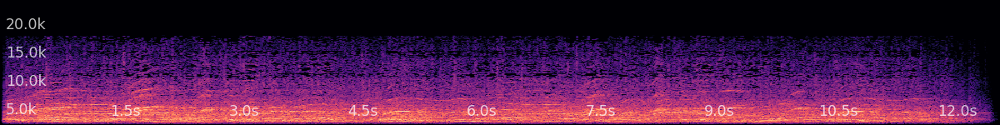

In [58]:
from librosa import load
import librosa

infile = examples[3]
y, sr = load(infile, sr=16000, offset=0.0, duration=3.0, mono=True)
print(y.shape)
y_shifted = librosa.effects.pitch_shift(y, sr=sr, n_steps=3)

AudioSignal(y, sample_rate=16000).widget()
made = AudioSignal(y_shifted, sample_rate=16000)
print(made.duration, e0.duration)
made.widget()
e0.widget()

(23406,)

In [1]:
from audiodataset import AudioDataset
from config import Config

cfg = Config()

tta = AudioDataset(cfg, data_path="/workspace/sound_test/train_0201.csv", train=True)

피치 변경
torch.Size([1, 48000]) The clear and crisp audio captures the sound of a person walking on a hard surface, with the audible noise of the shoes on the ground, high pitch 24918



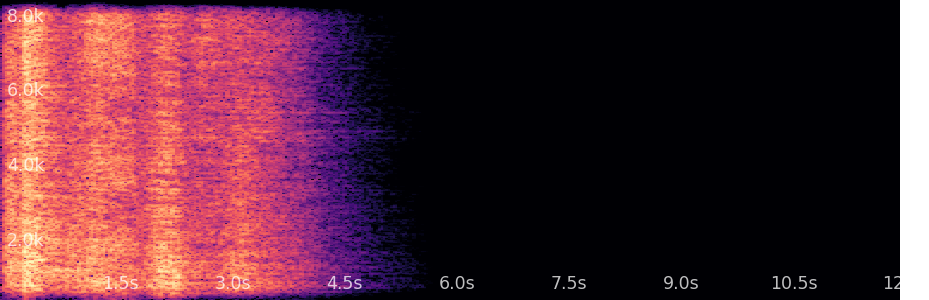
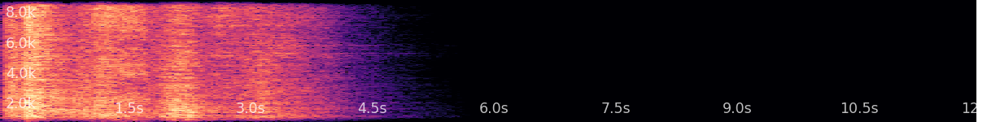


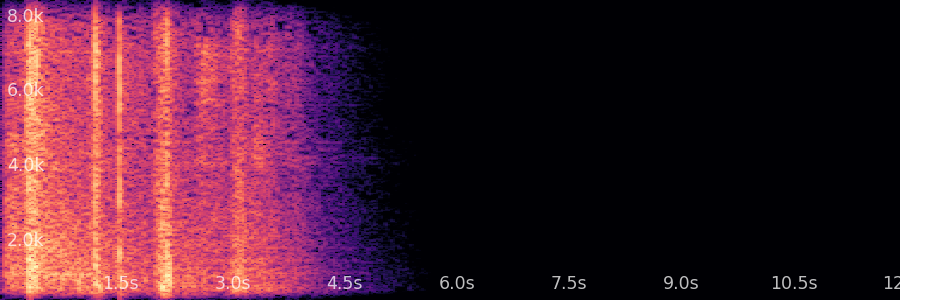
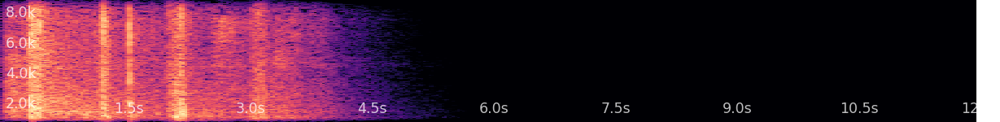

torch.Size([1, 48000]) The audio features a fast-paced drum beat with a high-pitched synthesizer playing in the background. The synthesizer is playing a fast-paced melody with a high-pitched sound. The audio is energetic and upbeat 132300



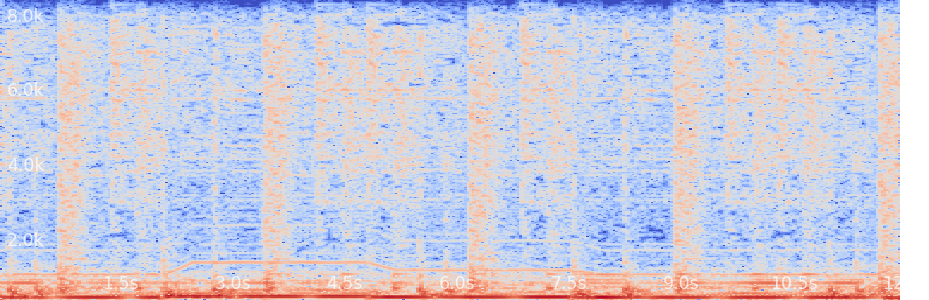
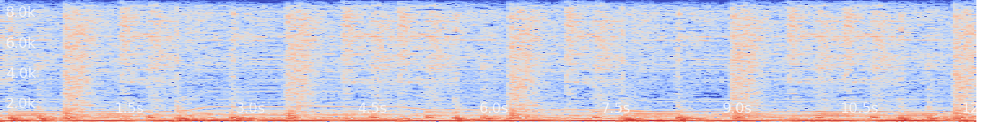


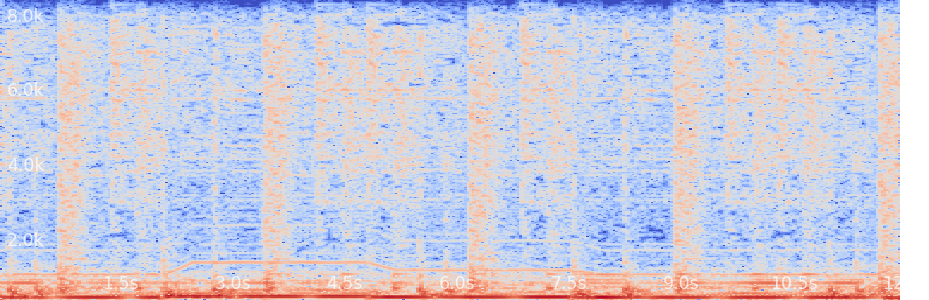
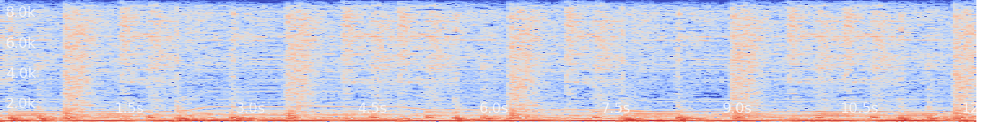

torch.Size([1, 48000]) foley clothing jeans denim pants trousers catch 9150



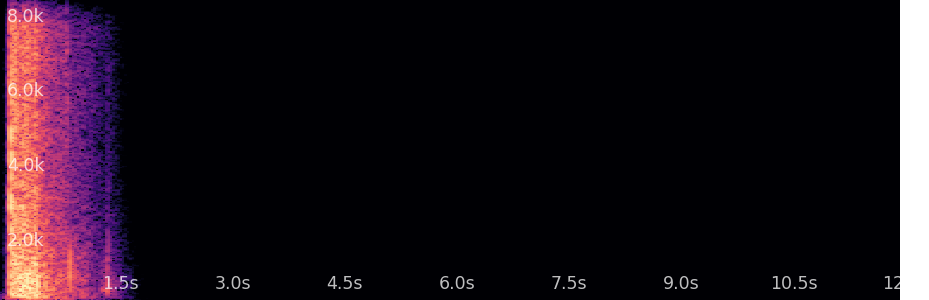
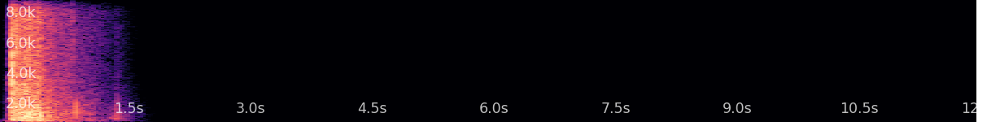


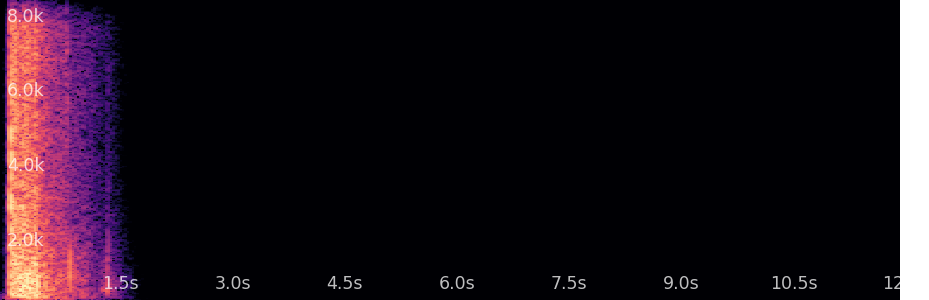
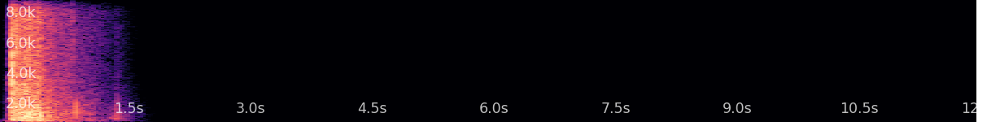

볼륨 변경
torch.Size([1, 48000]) human fart comical funny short, quietly 9879


KeyboardInterrupt: 

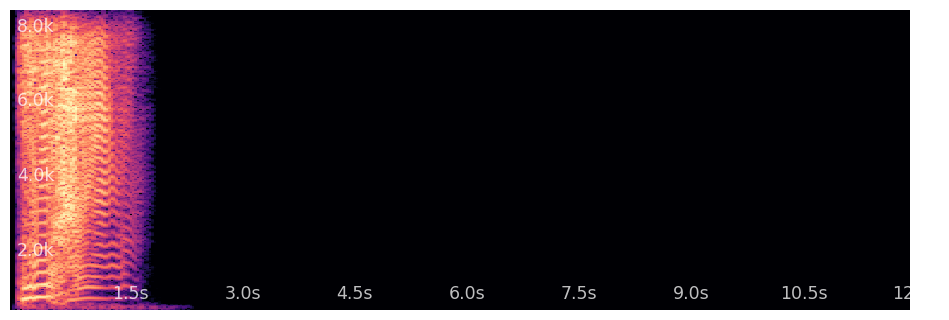

In [3]:
from audiotools import AudioSignal

for i in range(2040, 2090):
    data = tta[i]
    print(data[0].shape, data[1], data[2])
    AudioSignal(data[0], sample_rate=16000).widget()
    AudioSignal(data[3], sample_rate=16000).widget()

In [22]:
import numpy as np
import random
from audiotools import AudioSignal
import librosa
import pedalboard

reverb = pedalboard.Reverb()
reverb.room_size = 0.6
reverb.wet_level = 0.9

audio_path = "../dataset/09_wooden door shutting-01.mp3"
aaa = AudioSignal(audio_path, sample_rate=16000)
total_duration = aaa.duration

duration = 3 if total_duration >= 3 else total_duration
if total_duration < 3:
    offset = 0.0
else:
    max_offset = total_duration - duration
    offset = random.uniform(0, max_offset)

y, sr = librosa.load(audio_path, sr=16000, offset=offset, duration=duration, mono=True)
print(y.shape)
y_reverb = reverb(y, sample_rate=sr)
y_reverb = np.expand_dims(y_reverb, axis=0)
print(y_reverb.shape)

length=y_reverb.shape[1]
if total_duration < 3: # 3초보다 짧으면 패딩으로 채우기
  pad_len = int(3 * 16000) - length
  y_reverb = np.pad(y_reverb, pad_width=((0,0), (0, pad_len)), mode='constant', constant_values=0)
print(y_reverb.shape)

(17555,)
(1, 17555)
(1, 48000)


In [15]:
y_reverb.shape

(48000, 65554)